In [1]:
import numpy as np
import matplotlib.image as im
import matplotlib.pyplot as plt
from PIL import Image
from pathlib import Path

In [2]:
!unzip -qq /content/drive/MyDrive/ForMetrics/MetricsData.zip

In [3]:
TEST_1 = "/content/MetricsData/TestImages/2011_09_26_drive_0001_sync"
TEST_2 = "/content/MetricsData/TestImages/2011_09_26_drive_0020_sync"
GNDT_1 = "/content/MetricsData/GroundTruth/train/2011_09_26_drive_0001_sync"
GNDT_2 = "/content/MetricsData/GroundTruth/val/2011_09_26_drive_0020_sync"
DISP18 = "/content/MetricsData/Disparities/Resnet18"
DISP50 = "/content/MetricsData/Disparities/Resnet50"

In [ ]:
disp18 = np.load(Path(DISP18) / "disparities.npy")
disp50 = np.load(Path(DISP50) / "disparities.npy")

In [ ]:
disp18.shape, disp50.shape

((20, 256, 512), (20, 256, 512))

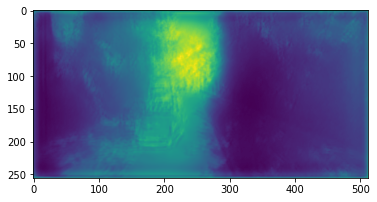

In [ ]:
plt.imshow(disp18[0])

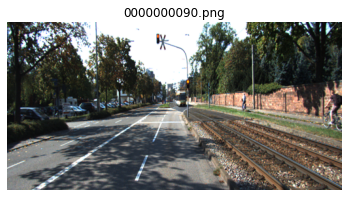

In [ ]:
i =0
timage = TEST_1 + "/" + str(90 + i).zfill(10) + ".png"
itit = timage.split('/')[-1]
img = np.asarray(Image.open(timage).resize((512,256)))
plt.title(itit)
plt.axis('off')
plt.imshow(img)

In [10]:
samplesd = {TEST_2: 70, TEST_1: 90}
def Visualize_samples(left_path=None, num_samples=None):
    row, col = num_samples,3
    img_start = samplesd[left_path]
    dbase = img_start - samplesd[TEST_2]
    if img_start == samplesd[TEST_1]:
      dbase -= 10
      
    plt.figure(figsize=(40,25))
    icount = 1
    for i in range(row):
      plt.subplot(row,col,icount)  
      timage = left_path + "/" + str(img_start + i).zfill(10) + ".png"
      itit = timage.split('/')[-1]
      img = np.asarray(Image.open(timage).resize((512,256)))
      plt.title(itit)
      plt.imshow(img)
      plt.axis('off')
      icount += 1  

      dcount = dbase + i
      plt.subplot(row,col,icount)
      plt.imshow(disp50[dcount])
      title="Disp50-"+str(dcount)
      plt.title(title)
      plt.axis('off')
      icount += 1
      
      plt.subplot(row,col,icount)  
      plt.imshow(disp18[dcount])
      title="Disp18-"+str(dcount)
      plt.title(title)
      plt.axis('off')
      icount += 1

    plt.tight_layout()
    plt.show()

In [ ]:
print(f"Number of Images: \nRestnet50: {disp50.shape[0]}, Restnet18: {disp18.shape[0]}")

Number of Images: 
Restnet50: 20, Restnet18: 20


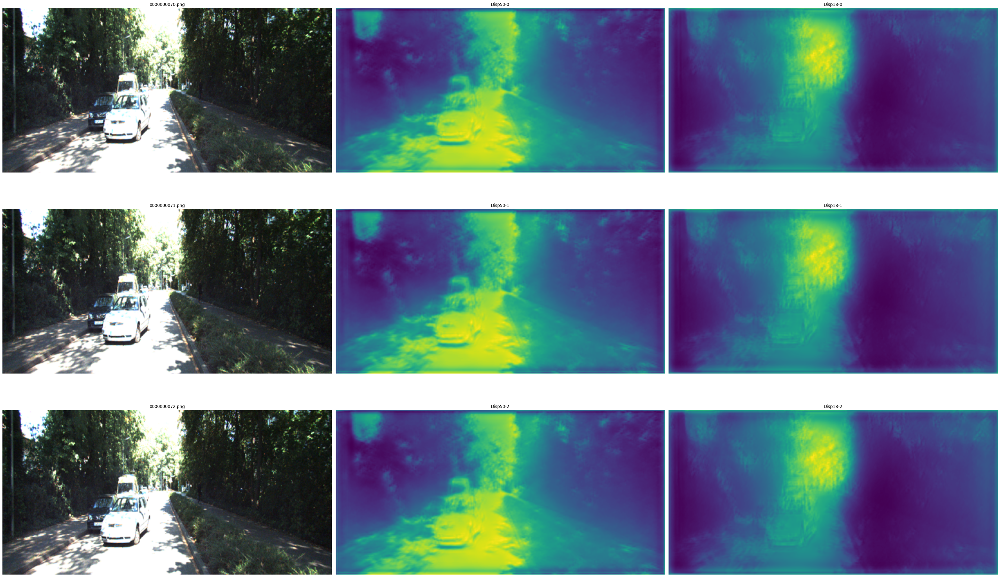

In [ ]:
Visualize_samples(left_path=TEST_2, num_samples=3)

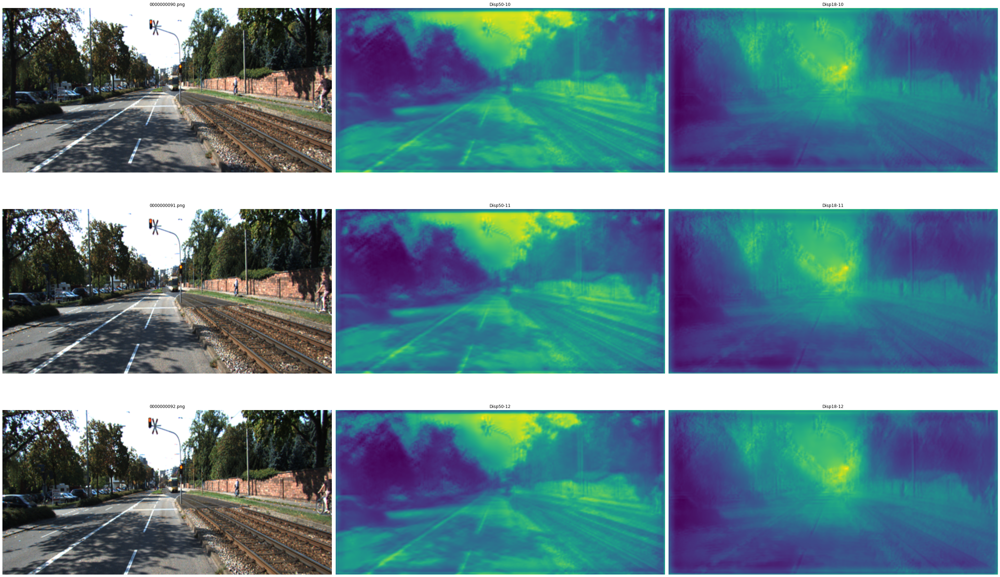

In [ ]:
Visualize_samples(left_path=TEST_1, num_samples=3)

In [6]:
!ls $DISP18 $DISP50

/content/MetricsData/Disparities/Resnet18:
disparities.npy  disparities_pp.npy

/content/MetricsData/Disparities/Resnet50:
disparities.npy  disparities_pp.npy


In [8]:
disp18 = np.load(Path(DISP18) / "disparities_pp.npy")
disp50 = np.load(Path(DISP50) / "disparities_pp.npy")
print(f"Number of Images: \nRestnet50: {disp50.shape[0]}, Restnet18: {disp18.shape[0]}")

Number of Images: 
Restnet50: 20, Restnet18: 20


Post processing disparities


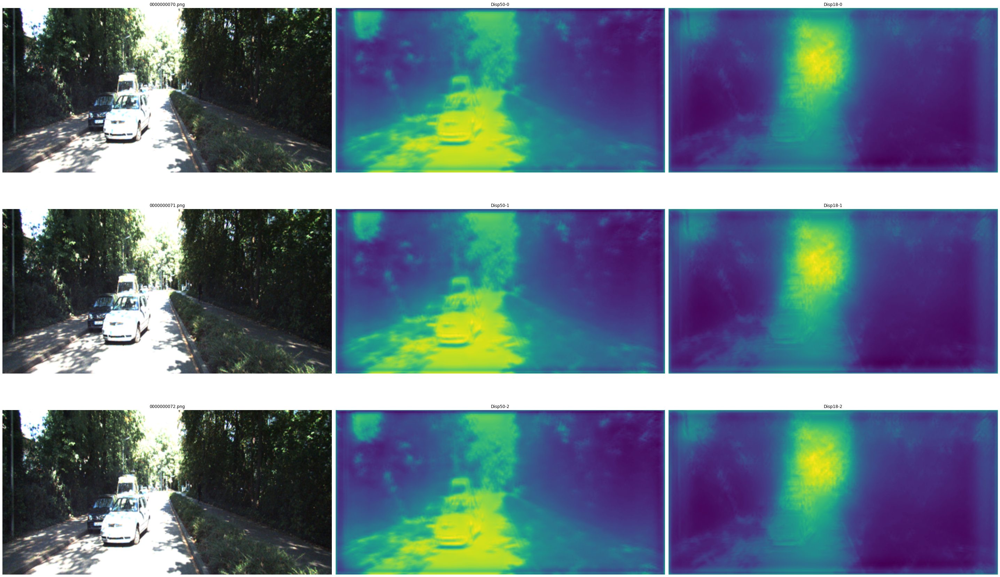

In [11]:
print("Post processing disparities")
Visualize_samples(left_path=TEST_2, num_samples=3)

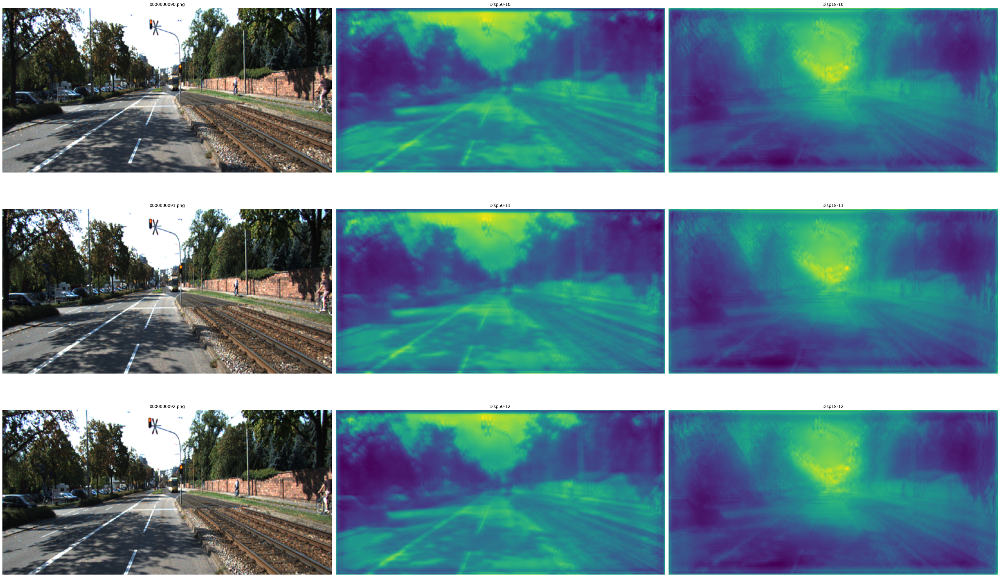

In [12]:
Visualize_samples(left_path=TEST_1, num_samples=3)